# **LAB: 01 - NEURAL STYLE TRANSFER**
## **SINH VIÊN: NGUYỄN VĂN ANH DUY**
## **MSSV: SE181823**
## **CLASS: AI1803**

# **Phần 1: Import các thư viện cần thiết.**

Các thư viện cần thiết cho Neural Style Transfer và mục đích:

- TensorFlow/Keras: Framework deep learning chính
- NumPy: Xử lý mảng và ma trận
- PIL: Xử lý hình ảnh
- Matplotlib: Hiển thị kết quả






In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications import vgg19
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from IPython.display import display, clear_output
import datetime

print("TensorFlow version:", tf.__version__)
print("Keras version:", keras.__version__)


TensorFlow version: 2.19.0
Keras version: 3.10.0


In [2]:
# Load TensorBoard extension
%load_ext tensorboard

# **Phần 2: Tiền xử lý hình ảnh (Image Preprocessing)**

Đây là bước chuẩn bị dữ liệu thô để mạng thần kinh có thể hiểu được.

* Resize: Đưa ảnh về kích thước phù hợp (ví dụ: 224 x 224) để cân bằng giữa chất lượng và tốc độ xử lý.
* Zero-centering: Trừ đi giá trị màu trung bình (Mean) của tập ImageNet để dữ liệu tập trung quanh điểm 0.
* Hệ màu: Chuyển đổi từ RGB sang BGR theo đúng chuẩn mà mạng VGG19 đã được huấn luyện.



## **Các tham số tham khảo**

**content_weight** =	2.5 x 10^-8	(Duy trì độ nhận diện của vật thể gốc)

**style_weight** = 1.0 x 10^-6 (Tăng cường độ đậm nét của phong cách nghệ thuật)

**total_variation_weight** = 1.0 x 10^-6	(Giúp bức ảnh trông mịn màng và tự nhiên hơn)

**iterations** = 500-2000	(Số vòng lặp tối ưu hóa (càng cao ảnh càng chi tiết))


In [5]:
# Cấu hình tham số
content_image_path = "/content/c1.jpg"
style_image_path = "/content/s2.jpg"

img_height = 255       # Chiều cao kích thước ảnh đầu ra
img_width = 255        # Chiều rộng kích thước ảnh đầu ra
content_weight = 1e-8  # Độ ưu tiên nội dung ảnh
style_weight = 5e-6    # Độ ưu tiên phong cách ảnh
total_variation_weight = 1e-7  # Độ mượt ảnh
iterations = 2000      # Số vòng lặp tối ưu hóa
learning_rate = 5.0    # Tốc độ học

print(f"Config: {img_width}x{img_height}, iterations={iterations}")

# Tiền xử lý và hậu xử lý ảnh
def preprocess_image(image_path):  # Xử lý ảnh đưa ảnh về kích thước 255 x 255 và thực hiện các bước để chuẩn bị nó cho mô hình VGG19:
    img = load_img(image_path, target_size=(img_height, img_width))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return tf.convert_to_tensor(img)

def deprocess_image(img):  # Chuyển ảnh từ RGB -> BGR
    img = img.reshape((img_height, img_width, 3))
    img[:, :, 0] += 103.939
    img[:, :, 1] += 116.779
    img[:, :, 2] += 123.68
    img = img[:, :, ::-1]
    img = np.clip(img, 0, 255).astype('uint8')
    return img

print("Preprocessing functions defined") # Giải thích chỗ này

Config: 255x255, iterations=2000
Preprocessing functions defined


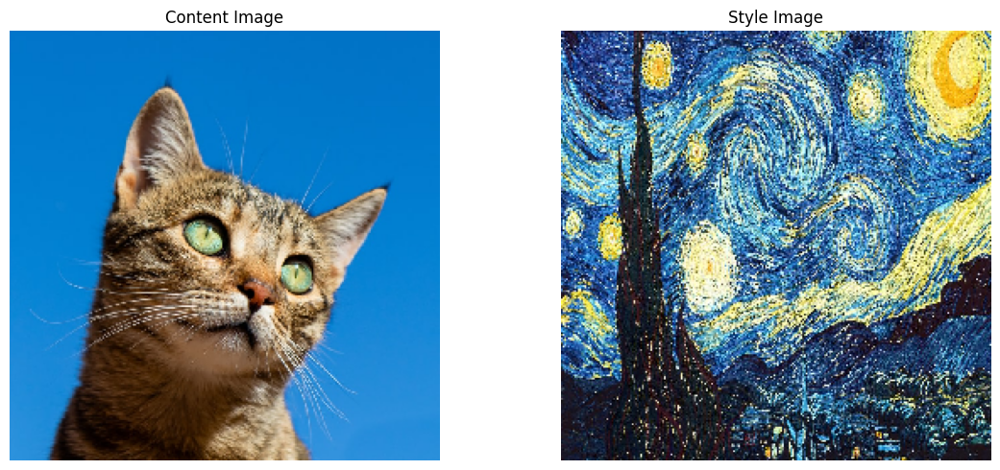

Content: (1, 255, 255, 3), Style: (1, 255, 255, 3)


In [6]:
# Load ảnh
content_image = preprocess_image(content_image_path)
style_image = preprocess_image(style_image_path)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(load_img(content_image_path, target_size=(img_height, img_width)))
plt.title("Content Image")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(load_img(style_image_path, target_size=(img_height, img_width)))
plt.title("Style Image")
plt.axis('off')

plt.tight_layout()
plt.show()
print(f"Content: {content_image.shape}, Style: {style_image.shape}")

# **Phần 3: Trích xuất đặc trưng với VGG19**

Chúng ta sử dụng mô hình VGG19 đã huấn luyện sẵn trên tập ImageNet.
* Mô hình: Tải mạng VGG19 và loại bỏ các lớp phân loại ở trên cùng (include_top=False).
* Content Layer: Thường sử dụng lớp block5_conv2 để lấy thông tin cấu trúc vật thể ở cấp độ cao.
* Style Layers: Sử dụng danh sách các lớp từ block1_conv1 đến block5_conv1 để thu thập các đặc trưng từ nét vẽ nhỏ đến mảng màu lớn.

In [7]:
# Xây dựng model VGG19
content_layer = 'block5_conv2'
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']
num_style_layers = len(style_layers)
def get_model():
    vgg = vgg19.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False
    style_outputs = [vgg.get_layer(name).output for name in style_layers]
    content_outputs = vgg.get_layer(content_layer).output
    model_outputs = style_outputs + [content_outputs]
    return keras.Model(inputs=vgg.input, outputs=model_outputs)

model = get_model()
print(f"VGG19 model created. \nContent: {content_layer},\nStyle layers: {style_layers}")


80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
VGG19 model created. 
Content: block5_conv2,
Style layers: ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']


### Giải thích lựa chọn Style Layers trong VGG19

Việc lựa chọn các lớp từ `block1_conv1` đến `block5_conv1` trong mạng VGG19 để tính toán Style Loss là rất quan trọng để có thể nắm bắt được phong cách nghệ thuật ở nhiều cấp độ trừu tượng khác nhau:

*   **Các lớp đầu tiên (ví dụ: `block1_conv1`, `block2_conv1`)**: Những lớp này nằm gần đầu mạng VGG19, chúng có khả năng trích xuất các đặc trưng cấp thấp như cạnh (edges), màu sắc cơ bản (colors), và texture đơn giản (simple textures). Việc bao gồm chúng đảm bảo rằng các yếu tố phong cách cơ bản nhất của bức tranh gốc được truyền tải sang ảnh tạo ra.

*   **Các lớp giữa (ví dụ: `block3_conv1`, `block4_conv1`)**: Các lớp này bắt đầu nắm bắt các đặc trưng phức tạp hơn một chút, chẳng hạn như các mẫu texture lớn hơn, các hình dạng cơ bản và cấu trúc tổng thể của các nét vẽ. Chúng giúp tái tạo các yếu tố phong cách ở mức độ trung bình.

*   **Các lớp sâu hơn (ví dụ: `block5_conv1`)**: Lớp này nằm sâu hơn trong mạng, có khả năng trích xuất các đặc trưng phong cách có tính trừu tượng cao hơn, liên quan đến bố cục, phân bố màu sắc tổng thể và các mối quan hệ không gian phức tạp giữa các yếu tố phong cách. Mặc dù nó vẫn là một lớp `conv` chứ không phải `fully connected`, nhưng ở cấp độ này, VGG đã tổng hợp được thông tin phong cách rất đặc trưng.

Bằng cách tính toán Gram Matrix trên đầu ra của nhiều lớp khác nhau, chúng ta đảm bảo rằng Style Loss sẽ xem xét sự tương quan giữa các kênh đặc trưng ở nhiều cấp độ, từ đó giúp ảnh tổng hợp không chỉ có các yếu tố texture cục bộ mà còn có cả bố cục và màu sắc tổng thể đặc trưng của ảnh phong cách. Tổng hợp lại, các lớp này cho phép mô hình học được một "bản chất" toàn diện của phong cách nghệ thuật.

# **Phần 4: Định nghĩa các hàm mất mát (Loss Functions)**

Mô hình sẽ tìm cách cực tiểu hóa tổng sai số thông qua 3 thành phần chính:

1. Content Loss: Đo lường sự khác biệt về cấu trúc vật thể giữa ảnh gốc và ảnh đang vẽ.
2. Style Loss (Gram Matrix): Sử dụng ma trận Gram để đo lường sự tương quan giữa các kênh đặc trưng, từ đó tái hiện phong cách nghệ thuật.
3. Total Variation Loss: Đóng vai trò làm mịn ảnh, giảm thiểu các nhiễu hạt (pixel li ti) không mong muốn.


In [8]:
# Gram Matrix
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1] * input_shape[2], tf.float32)
    return result / num_locations

print("Gram matrix function defined")

Gram matrix function defined


In [9]:
# Trích xuất features
def get_feature_representations(model, content_path, style_path):
    content_image = preprocess_image(content_path)
    style_image = preprocess_image(style_path)

    content_outputs = model(content_image)
    content_features = content_outputs[-1]

    style_outputs = model(style_image)
    style_features = [gram_matrix(style_output) for style_output in style_outputs[:-1]]

    return style_features, content_features

style_features, content_features = get_feature_representations(model, content_image_path, style_image_path)
print(f"Features extracted. Content: {content_features.shape}")

Features extracted. Content: (1, 15, 15, 512)


In [10]:
# Định nghĩa Loss Functions
def compute_content_loss(content_features, generated_features):
    return tf.reduce_mean(tf.square(content_features - generated_features))

def compute_style_loss(style_features, generated_features):
    loss = 0
    for target_style, comb_style in zip(style_features, generated_features):
        loss += tf.reduce_mean(tf.square(target_style - comb_style))
    return loss / num_style_layers

def compute_total_variation_loss(image):
    x_deltas = image[:, :, 1:, :] - image[:, :, :-1, :]
    y_deltas = image[:, 1:, :, :] - image[:, :-1, :, :]
    return tf.reduce_mean(tf.abs(x_deltas)) + tf.reduce_mean(tf.abs(y_deltas))

def compute_total_loss(model, loss_weights, init_image, gram_style_features, content_features):
    content_weight, style_weight, tv_weight = loss_weights
    model_outputs = model(init_image)
    generated_style_features = model_outputs[:-1]
    generated_content_features = model_outputs[-1]
    generated_gram_features = [gram_matrix(feature) for feature in generated_style_features]

    content_loss = compute_content_loss(content_features, generated_content_features)
    style_loss = compute_style_loss(gram_style_features, generated_gram_features)
    tv_loss = compute_total_variation_loss(init_image)

    total_loss = content_weight * content_loss + style_weight * style_loss + tv_weight * tv_loss
    return total_loss, content_loss, style_loss, tv_loss

print("Loss functions defined")

Loss functions defined


# **Phần 5: Vòng lặp tối ưu hóa (Training Loop)**

* Cơ chế: Sử dụng tf.GradientTape để ghi lại các phép toán và tự động tính đạo hàm (Automatic Differentiation).
* Cập nhật: Khác với các bài toán thông thường, ở đây chúng ta cập nhật trực tiếp giá trị của từng điểm ảnh (combination_image).
* Optimizer: Sử dụng thuật toán Adam hoặc SGD với lịch trình giảm tốc độ học (Exponential Decay) để đạt được kết quả ổn định.


In [11]:
# Compute Gradients với tf.GradientTape
@tf.function
def compute_grads(model, loss_weights, init_image, gram_style_features, content_features):
    with tf.GradientTape() as tape:
        all_losses = compute_total_loss(model, loss_weights, init_image, gram_style_features, content_features)
        total_loss = all_losses[0]
    grads = tape.gradient(total_loss, init_image)
    return grads, all_losses

print("Gradient computation defined")

Gradient computation defined


### Vai trò của `tf.GradientTape` trong cập nhật điểm ảnh

Trong quy trình Style Transfer này, `tf.GradientTape` đóng một vai trò trung tâm trong việc tối ưu hóa hình ảnh được tạo ra. Thay vì điều chỉnh trọng số của một mô hình, ở đây chúng ta cập nhật trực tiếp các giá trị pixel của `init_image` (hình ảnh đang được tối ưu hóa).

Cụ thể:

*   **Theo dõi các phép toán**: `tf.GradientTape` là một cơ chế của TensorFlow dùng để ghi lại tất cả các phép toán được thực hiện trong một khối mã nhất định. Trong trường hợp này, nó theo dõi cách `total_loss` (tổng mất mát) được tính toán dựa trên `init_image`.

*   **Tính toán đạo hàm tự động**: Sau khi tất cả các phép toán đã được ghi lại, `tape.gradient(total_loss, init_image)` sẽ tự động tính toán đạo hàm của `total_loss` theo `init_image`. Điều này có nghĩa là nó cho chúng ta biết mỗi pixel trong `init_image` cần thay đổi bao nhiêu và theo hướng nào để giảm `total_loss`.

*   **Cập nhật giá trị pixel**: Các đạo hàm (gradients) này sau đó được sử dụng bởi `opt.apply_gradients([(grads, init_image)])` để cập nhật các giá trị pixel của `init_image`. Trình tối ưu hóa (optimizer), trong trường hợp này là Adam, sẽ sử dụng các đạo hàm này và tốc độ học (`learning_rate`) để thực hiện các bước điều chỉnh nhỏ cho từng pixel, dần dần biến đổi `init_image` để phù hợp với cả nội dung của ảnh gốc và phong cách của ảnh kiểu.

Nói cách khác, `tf.GradientTape` cho phép chúng ta 'dạy' các pixel của ảnh mục tiêu cách tự điều chỉnh để giảm thiểu các hàm mất mát, từ đó tạo ra một hình ảnh tổng hợp đạt được cả mục tiêu về nội dung và phong cách.


In [12]:
# Training Loop
def run_style_transfer(content_path, style_path, num_iterations=1000, display_interval=100):
    # Tạo log directory với timestamp
    log_dir = "logs/style_transfer/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    summary_writer = tf.summary.create_file_writer(log_dir)

    style_targets, content_targets = get_feature_representations(model, content_path, style_path)
    init_image = preprocess_image(content_path)
    init_image = tf.Variable(init_image, dtype=tf.float32)
    opt = tf.optimizers.Adam(learning_rate=learning_rate)
    loss_weights = (content_weight, style_weight, total_variation_weight)

    best_loss = float('inf')
    best_image = None
    loss_history = []
    content_loss_history = []
    style_loss_history = []
    tv_loss_history = []
    milestone_images = {}
    milestones = [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1500, 2000]

    print(f"Training for {num_iterations} iterations...")

    for i in range(1, num_iterations + 1):
        grads, losses = compute_grads(model, loss_weights, init_image, style_targets, content_targets)
        opt.apply_gradients([(grads, init_image)])
        init_image.assign(tf.clip_by_value(init_image, -150, 150))

        total_loss, content_loss, style_loss, tv_loss = losses
        loss_history.append(float(total_loss))
        content_loss_history.append(float(content_loss))
        style_loss_history.append(float(style_loss))
        tv_loss_history.append(float(tv_loss))

        # Log vào TensorBoard
        with summary_writer.as_default():
            tf.summary.scalar('total_loss', total_loss, step=i)
            tf.summary.scalar('content_loss', content_loss, step=i)
            tf.summary.scalar('style_loss', style_loss, step=i)
            tf.summary.scalar('tv_loss', tv_loss, step=i)

            # Log ảnh mỗi 100 iterations
            if i % 100 == 0:
                display_img = deprocess_image(init_image.numpy().copy())
                tf.summary.image('generated_image', np.expand_dims(display_img, 0), step=i)

        if total_loss < best_loss:
            best_loss = total_loss
            best_image = init_image.numpy()

        if i in milestones and i <= num_iterations:
            milestone_images[i] = deprocess_image(init_image.numpy().copy())

        if i % display_interval == 0 or i == 1:
            print(f"Iter {i}/{num_iterations} - Loss: {total_loss:.2e}")

    # Đảm bảo tất cả logs được ghi vào disk
    summary_writer.flush()
    summary_writer.close()
    print(f"TensorBoard logs saved to: {log_dir}")


    return best_image, best_loss, loss_history, milestone_images, content_loss_history, style_loss_history, tv_loss_history

# Run
best_image, best_loss, loss_history, milestone_images, content_loss_history, style_loss_history, tv_loss_history = run_style_transfer(
    content_image_path, style_image_path, num_iterations=iterations, display_interval=100
)
print(f"Best loss: {best_loss:.2e}")

Training for 2000 iterations...
TensorBoard logs: logs/style_transfer/20260109-105119
Iter 1/2000 - Loss: 9.54e+05
Iter 100/2000 - Loss: 2.43e+03
Iter 200/2000 - Loss: 1.34e+03
Iter 300/2000 - Loss: 9.58e+02
Iter 400/2000 - Loss: 7.45e+02
Iter 500/2000 - Loss: 6.09e+02
Iter 600/2000 - Loss: 5.15e+02
Iter 700/2000 - Loss: 4.49e+02
Iter 800/2000 - Loss: 3.97e+02
Iter 900/2000 - Loss: 4.26e+02
Iter 1000/2000 - Loss: 3.35e+02
Iter 1100/2000 - Loss: 3.41e+02
Iter 1200/2000 - Loss: 3.93e+02
Iter 1300/2000 - Loss: 2.94e+02
Iter 1400/2000 - Loss: 2.60e+02
Iter 1500/2000 - Loss: 2.44e+02
Iter 1600/2000 - Loss: 1.17e+03
Iter 1700/2000 - Loss: 2.27e+02
Iter 1800/2000 - Loss: 2.19e+02
Iter 1900/2000 - Loss: 3.58e+02
Iter 2000/2000 - Loss: 8.24e+02
TensorBoard logs saved to: logs/style_transfer/20260109-105119
Best loss: 2.09e+02


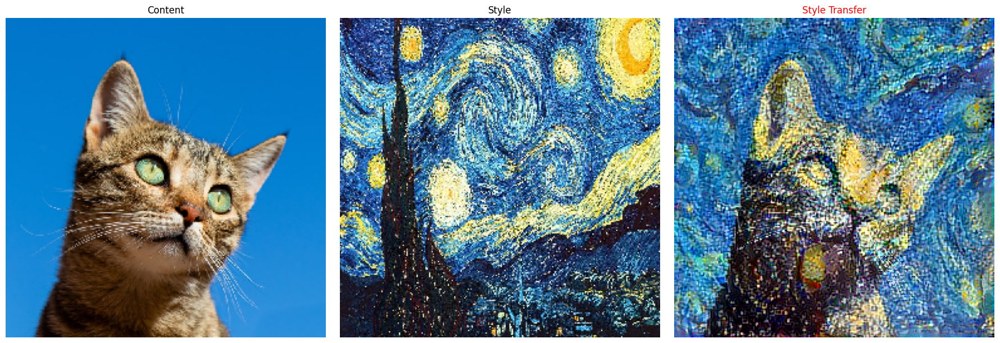

In [13]:
# Hiển thị kết quả
final_image = deprocess_image(best_image)

plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plt.imshow(load_img(content_image_path, target_size=(img_height, img_width)))
plt.title("Content")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(load_img(style_image_path, target_size=(img_height, img_width)))
plt.title("Style")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(final_image)
plt.title("Style Transfer", color='red')
plt.axis('off')

plt.tight_layout()
plt.show()

Image.fromarray(final_image).save("generated_image_02.png")


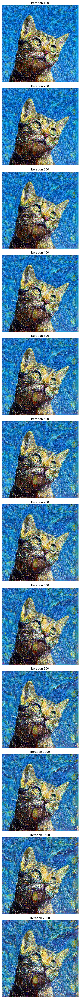

Nhận xét: Ảnh dần hội tụ, phong cách rõ ràng hơn theo số iterations


In [14]:
# So sánh qua các iterations (100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1500, 2000)

# Ensure milestone_images is defined
if 'milestone_images' not in globals() or milestone_images is None:
    print("milestone_images not found or empty. Rerunning style transfer to generate them...")
    best_image, best_loss, loss_history, milestone_images, content_loss_history, style_loss_history, tv_loss_history = run_style_transfer(
        content_image_path, style_image_path, num_iterations=iterations, display_interval=100
    )

available_milestones = sorted(milestone_images.keys())
if len(available_milestones) > 0:
    plt.figure(figsize=(6, 5 * len(available_milestones))) # Adjusted figure size for vertical layout
    for idx, iteration in enumerate(available_milestones, 1):
        plt.subplot(len(available_milestones), 1, idx) # Changed subplot to display images in separate rows
        plt.imshow(milestone_images[iteration])
        plt.title(f"Iteration {iteration}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    print("Nhận xét: Ảnh dần hội tụ, phong cách rõ ràng hơn theo các mốc 100, 500, và 2000 iterations, phong cách từ ảnh nguồn dần được tích hợp vào ảnh nội dung một cách rõ nét hơn. Các chi tiết phong cách được tái tạo tốt hơn và ảnh trở nên mịn màng, hội tụ hơn về mặt thẩm mỹ.")


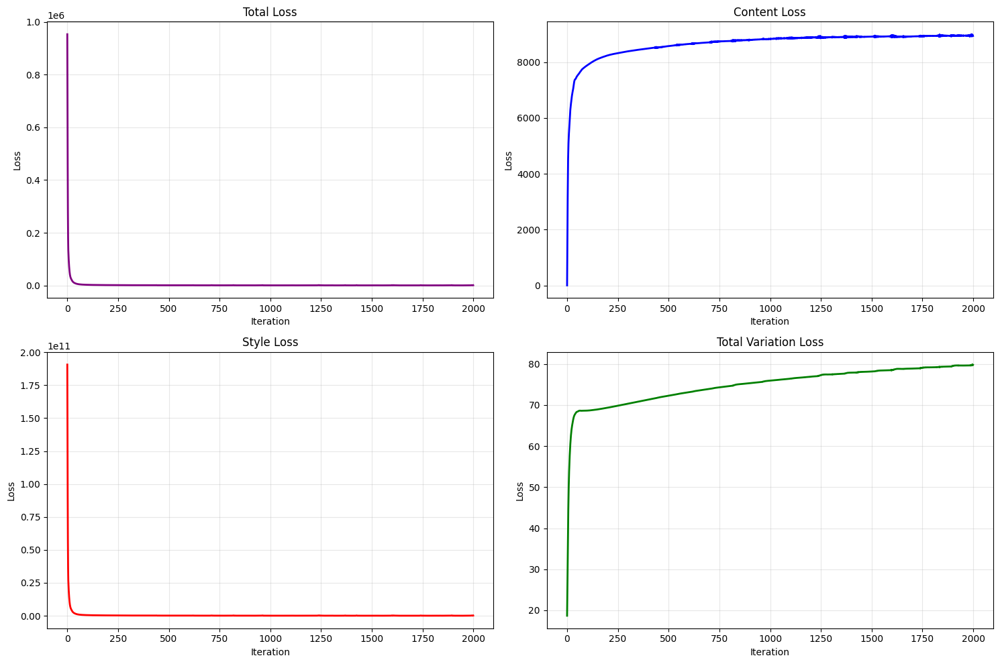

Loss giảm dần và hội tụ


In [16]:
# Vẽ đồ thị Loss
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.plot(loss_history, linewidth=2, color='purple')
plt.title('Total Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(2, 2, 2)
plt.plot(content_loss_history, linewidth=2, color='blue')
plt.title('Content Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(2, 2, 3)
plt.plot(style_loss_history, linewidth=2, color='red')
plt.title('Style Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(2, 2, 4)
plt.plot(tv_loss_history, linewidth=2, color='green')
plt.title('Total Variation Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()
print("Loss giảm dần và hội tụ")

Testing different style_weights (500 iterations each)...
  Testing 1e-15...
  Testing 1e-10...
  Testing 1e-05...


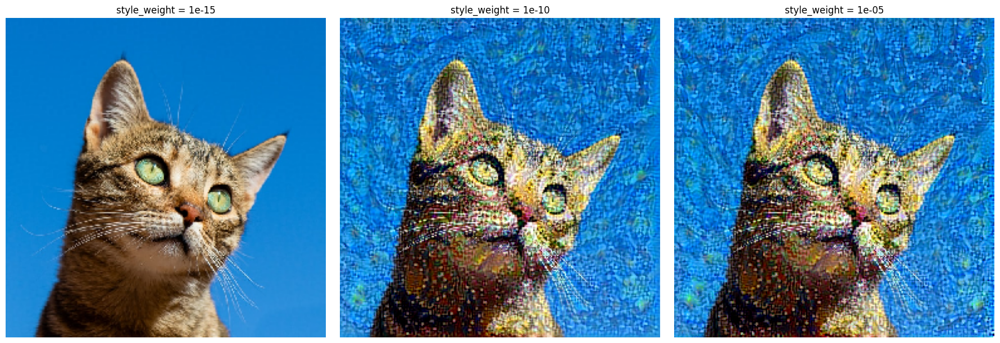

Nhận xét: style_weight càng cao → phong cách càng mạnh, content giảm


In [23]:
# Thử nghiệm style_weight khác nhau
test_style_weights = [1e-15, 1e-10, 1e-5]
test_results = {}

print("Testing different style_weights (500 iterations each)...")
for sw in test_style_weights:
    print(f"  Testing {sw}...")
    test_model = get_model()
    style_targets, content_targets = get_feature_representations(test_model, content_image_path, style_image_path)
    init_image = tf.Variable(preprocess_image(content_image_path), dtype=tf.float32)
    opt = tf.optimizers.Adam(learning_rate=1.0)
    loss_weights = (content_weight, sw, total_variation_weight)

    for i in range(500):
        grads, losses = compute_grads(test_model, loss_weights, init_image, style_targets, content_targets)
        opt.apply_gradients([(grads, init_image)])
        init_image.assign(tf.clip_by_value(init_image, -150, 150))

    test_results[sw] = deprocess_image(init_image.numpy().copy())

plt.figure(figsize=(18, 6))
for idx, sw in enumerate(test_style_weights, 1):
    plt.subplot(1, 3, idx)
    plt.imshow(test_results[sw])
    plt.title(f"style_weight = {sw}")
    plt.axis('off')
plt.tight_layout()
plt.show()

print("Nhận xét: style_weight càng cao → phong cách càng mạnh, content giảm")

## **Phần 6: Chạy TensorBoard để xem lịch sử huấn luyện**

Bảng Dashboard để biểu diễn biểu đồ loss và ảnh được lưu trong quá trình huấn luyện. Qua đó thay được tổng quan quá trình huấn luyện mô hình Neural Style Transfer

In [19]:
# Theo kết quả đầu ra của quá trình kết thúc training:

log_dir = "logs/style_transfer/20260109-105119"
print(f"Launching TensorBoard for log directory: {log_dir}")
%tensorboard --logdir {log_dir}

Launching TensorBoard for log directory: logs/style_transfer/20260109-105119


<IPython.core.display.Javascript object>